# Combined 

In [1]:
import os
import sys
print(sys.version)
sys.path.extend(['./COMMON_UTILS/'])

3.9.10 (main, Feb  9 2022, 11:11:48) 
[GCC 11.1.0]


In [2]:
from importlib import reload

import pickle as pkl

import numpy as np
import matplotlib.pyplot as plt

import torch
import librosa

from IPython.display import display, Audio

In [3]:
from utils import plot_audio

import tempo_align
reload(tempo_align)
from tempo_align import warpAudio, quantiseAudio

from drum_processor import getDownbeats
from drum_decomposition import getDecomposition, plotDecomposition, isolateSources

In [4]:
plt.rcParams['figure.figsize'] = (15, 5)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'computing on {device}')

computing on cuda


In [5]:
def play(y, sr, **kwargs):
    display(Audio(y, rate=sr, **kwargs))

### Load Audio 

In [6]:
SRC = './PROCESSED/dem_bow'
# DST = './PROCESSED/neil_young'
DST = './PROCESSED/gary_numan_electric'

# DST = './PROCESSED/stereofuse_casino_04'
# SRC = './PROCESSED/astrud_gilberto'

In [7]:
y_src, sr = librosa.load(os.path.join(SRC, 'DRUMS/drums.wav'), sr=44100)
y_dst, _ = librosa.load(os.path.join(DST, 'DRUMS/drums.wav'), sr=sr)
y_dst_full, _ = librosa.load(os.path.join(DST, 'source.wav'), sr=sr)

In [8]:
stems = []
for s in ['vocals', 'bass', 'other']:
    y_ins, _ = librosa.load(os.path.join(DST, s.upper(), f'{s}.wav'), sr=sr)
    stems.append(y_ins)
y_dst_ins = np.sum(stems, axis=0)

In [9]:
display(Audio(y_dst_ins, rate=sr))

In [10]:
tempo_src = librosa.beat.tempo(y=y_src, sr=sr)
tempo_dst = librosa.beat.tempo(y=y_dst, sr=sr)
print(tempo_src, tempo_dst)

[99.38401442] [92.28515625]


In [11]:
db_src = getDownbeats(
    os.path.join(SRC, 'source.wav'), 
    transition_lambda=64, 
    min_bpm=tempo_src*0.8,
    max_bpm=tempo_src*1.2
)

/home/arran/.pyenv/versions/3.9.10/lib/python3.9/site-packages/madmom/features/downbeats.py:287: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  best = np.argmax(np.asarray(results)[:, 1])


In [149]:
y_src, db_src = quantiseAudio(y_src, sr, db_src, hq=True)

In [120]:
db_dst = getDownbeats(
    os.path.join(DST, 'source.wav'), 
    transition_lambda=64, 
    min_bpm=tempo_dst*0.7,
    max_bpm=tempo_dst*1.3
)

In [150]:
# quantise beats
y_dst, db_dst = quantiseAudio(y_dst, sr, db_dst, hq=True)

In [151]:
y_src_metro = librosa.clicks(times=db_src, sr=sr, length=len(y_src))
y_dst_metro = librosa.clicks(times=db_dst, sr=sr, length=len(y_dst))

In [152]:
play(y_src + y_src_metro, sr)
play(y_dst + y_dst_metro, sr)

In [153]:
y_src_warped, y_dst_synced, downbeats, idxs_src, idxs_dst = warpAudio(
    y_src, y_dst, db_src, db_dst, sr
)

In [154]:
assert y_src_warped.shape == y_dst_synced.shape

In [155]:
y_ins_segment = y_dst_ins[idxs_dst[0]: idxs_dst[1]]

In [156]:
play(y_src_warped, sr, autoplay=True)
play(y_dst_synced, sr, autoplay=True)

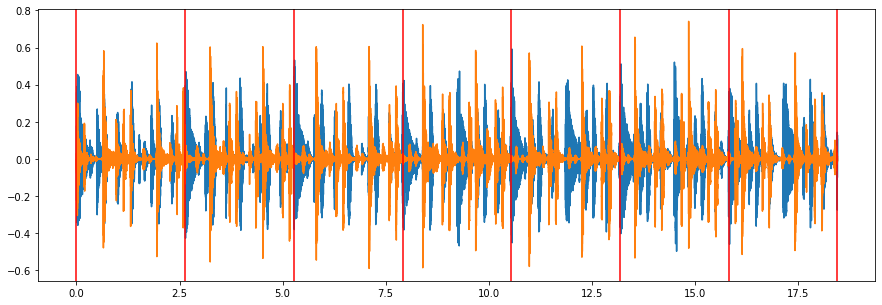

In [157]:
ax = plot_audio(y_src_warped, sr)
plot_audio(y_dst_synced, sr, ax=ax)
for db in downbeats:
    ax.axvline(db, color='red')

In [158]:
y_metronome = librosa.clicks(times=downbeats, sr=sr, length=len(y_dst_synced))

In [159]:
play(y_metronome + y_dst_synced, sr)

### Decompose Drums

In [17]:
with open('./drum_templates.pkl', 'rb') as f:
    templates = pkl.load(f)
    
kd_temp = templates['kd_temp']
sd_temp = templates['sd_temp']
hh_temp = templates['hh_temp']

W_0 = np.stack([kd_temp, sd_temp, hh_temp], axis=1)
W_0 = torch.from_numpy(W_0).to(device)

In [18]:
W_src, H_src, V_src, _, net_src = getDecomposition(
    y_src_warped, R=3, W=W_0, trainable_W=True
)

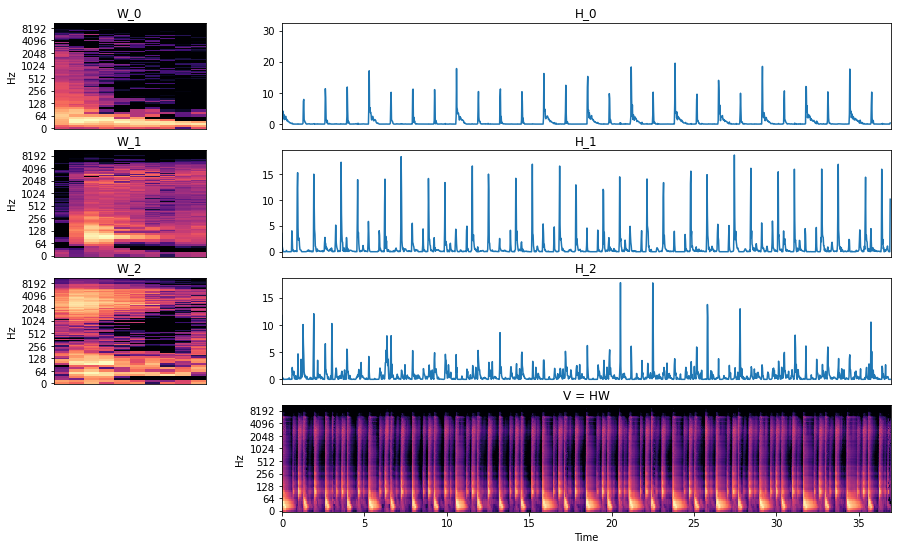

In [19]:
plotDecomposition(W_src, H_src, V_src)

In [20]:
y_s = isolateSources(net_src)

for y in y_s:
    play(y, sr)

In [21]:
W_dst, H_dst, V_dst, _, net_dst = getDecomposition(y_dst_synced, R=3, W=W_0)

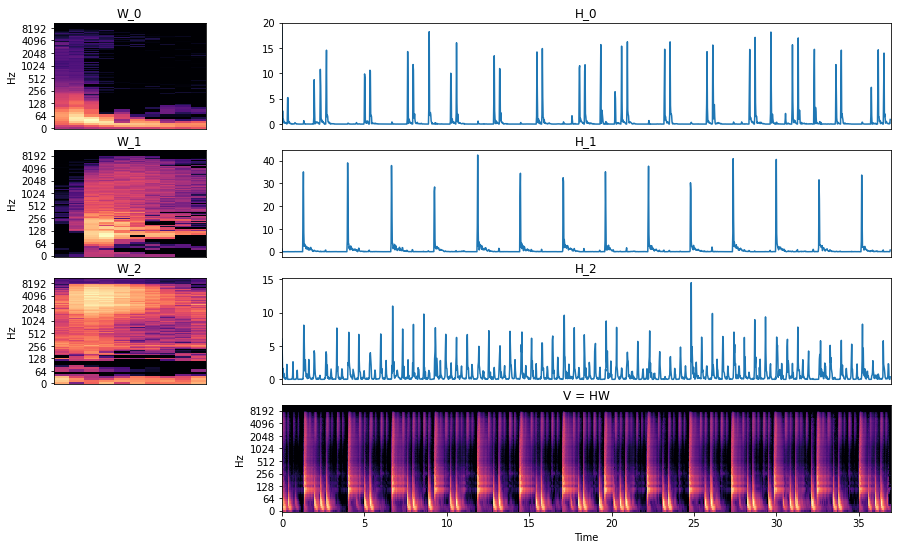

In [22]:
plotDecomposition(W_dst, H_dst, V_dst)

In [23]:
y_d = isolateSources(net_dst)

for y in y_d:
    play(y, sr)

### Morph Activations 

#### Full Transformation 

In [45]:
H_hat = torch.from_numpy(H_src)
for i in range(H_src.shape[0]):
    scale = net_dst.H[0, i].max() / H_src[i].max()
    H_hat[i] *= scale

In [46]:
V_hat = net_dst.reconstruct(
    net_dst.W, H_hat.unsqueeze(0)
).detach().cpu().squeeze().numpy()

In [47]:
y_r = librosa.griffinlim(V_hat)

In [57]:
y_final = np.sum([y_r, y_ins_segment[:len(y_r)]], axis=0)

In [58]:
play(y_final, sr)

#### Percent Transformed 

#### Transition 

In [35]:
db_frames = librosa.time_to_frames(downbeats, sr=sr)[1:]

In [36]:
H_src_bars = np.split(H_src, db_frames, axis=1)
H_dst_bars = np.split(H_dst, db_frames, axis=1)

In [44]:
# transform from DST (original) to SRC

In [ ]:
librosa.time_to_samples()